In [1]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras import initializers
from tensorflow.keras import regularizers
from sklearn import datasets
import pandas as pd
import numpy as np
print(tf.__version__)

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

2.3.0


# Case Study 4: Neural Networks

**Matt Chinchilla  
Rikel Djoko  
Drew Larsen**

## Business Case:

The field of high-energy physics is devoted to the study of the physical universe. Through the investigation of structures of matter and the laws that govern it’s interactions physicists strive to discover how the physical universe works. Collisions of high-energy particle is a primary research method for the discovery of new and exotic particle. When particle collision experiments are conducted at sites like the Large Hadron Collider discovery of rare and exotic particles involves solving complex signal vs background classification problems. Machine learning techniques are the principle means researches have employed in order to do this classification. 

Traditionally researchers have relied on “shallow” neural network machine learning models but there are drawbacks to these models such as an inability to learn complex nonlinear functions of the input data.  Although manually constructed nonlinear features have been painstakingly built by researchers progress addressing classification of signal vs noise of exotic particles has slowed. As the field of machine learning has advanced deep learning neural networks are being explored as a means to learn more complex functions and more precisely identify signal and background classes. In order to test new deep learning models a benchmark case for discovery of Higgs bosons was used. Work to improve classification using deep learning neural networks was first published in 2014. 

A representation of the model that was discussed in 2014 will be presented in this paper. Unfortunately many of the packages used for the initial research have been deprecated so the code has been translated as closely as possible using tensor flow for python. Along with exploring the initial deep learning approach from 2014 we will build on this research and suggest recommendations for improving the deep learning models to more clearly distinguish Higgs Bosons and background signals. Model comparison will primarily be focused on comparing the Area under the receiver operating characteristic curve or AUC. A larger AUC value indicates higher classification accuracy across a range of threshold choices.


## Data Quality 

To remain consistent with the research into Neural networks conducted in 2014 we will be using the same training data set which can be found at https://archive.ics.uci.edu/ml/datasets/HIGGS . The data set consists of 11 million observations across 28 predictive variables and 1 classification variable. The 28 features include 21 low level features and 7 high level features. 


Place holder for feature table

### Data Exploration

To ensure completeness we explored the data and found that there were no missing values throughout the 11 million rows as illustrated below. We also used the pandas profiling package to conduct a more thorough exploration of the data. Because the complete data set is 11million rows a 1% sample of the data was taken to ensure the package could complete the analysis. Below is the pandas profiling report along with overview data of the complete data set.


| Feature                  | Level |
|--------------------------|-------|
| lepton pt                | low   |
| lepton eta               | low   |
| lepton phi               | low   |
| missing energy magnitude | low   |
| jet 1 pt                 | low   |
| jet 1 eta                | low   |
| jet 1 phi                | low   |
| jet 1 b-tag              | low   |
| jet 2 pt                 | low   |
| jet 2 eta                | low   |
| jet 2 phi                | low   |
| jet 2 b-tag              | low   |
| jet 3 pt                 | low   |
| jet 3 eta                | low   |
| jet 3 phi                | low   |
| jet 3 b-tag              | low   |
| jet 4 pt                 | low   |
| jet 4 eta                | low   |
| jet 4 phi                | low   |
| jet 4 b-tag              | low   |
| m_jj                     | high  |
| m_jjj                    | high  |
| m_lv                     | high  |
| m_jlv                    | high  |
| m_bb                     | high  |
| m_wbb                    | high  |
| m_wwbb                   | high  |

In [1]:
import pandas as pd
from pandas_profiling import ProfileReport


data = pd.read_csv('HIGGS.csv') 

In [2]:
#1. adding column name
col = "label, lepton pT, lepton eta, lepton phi, missing energy magnitude, missing energy phi, jet 1 pt, jet 1 eta, jet 1 phi, jet 1 b-tag, jet 2 pt, jet 2 eta, jet 2 phi, jet 2 b-tag, jet 3 pt, jet 3 eta, jet 3 phi, jet 3 b-tag, jet 4 pt, jet 4 eta, jet 4 phi, jet 4 b-tag, m_jj, m_jjj, m_lv, m_jlv, m_bb, m_wbb, m_wwbb"
columns = col.split(",")
for i in range(0, len(columns)):
   columns[i] = columns[i].strip()
data.columns = columns

data.head()
data.describe()
data.info(null_counts = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10999999 entries, 0 to 10999998
Data columns (total 29 columns):
 #   Column                    Non-Null Count     Dtype  
---  ------                    --------------     -----  
 0   label                     10999999 non-null  float64
 1   lepton pT                 10999999 non-null  float64
 2   lepton eta                10999999 non-null  float64
 3   lepton phi                10999999 non-null  float64
 4   missing energy magnitude  10999999 non-null  float64
 5   missing energy phi        10999999 non-null  float64
 6   jet 1 pt                  10999999 non-null  float64
 7   jet 1 eta                 10999999 non-null  float64
 8   jet 1 phi                 10999999 non-null  float64
 9   jet 1 b-tag               10999999 non-null  float64
 10  jet 2 pt                  10999999 non-null  float64
 11  jet 2 eta                 10999999 non-null  float64
 12  jet 2 phi                 10999999 non-null  float64
 13  jet 2 b-ta

In [3]:
sample = data.sample(frac = .001,random_state=30)

If the below pandas profiling report does not render, please see the supplemental HTML file. 

In [5]:
profile = ProfileReport(sample,correlations= None )
profile.to_notebook_iframe()

In [5]:
print("{:>25}{:>10,} x {:,}\n".format("Shape of raw data is ", data.shape[0], data.shape[1]))

    Shape of raw data is    100,000 x 29



In [6]:
data.head()

,1.000000000000000000e+00,8.692932128906250000e-01,-6.350818276405334473e-01,2.256902605295181274e-01,3.274700641632080078e-01,-6.899932026863098145e-01,7.542022466659545898e-01,-2.485731393098831177e-01,-1.092063903808593750e+00,0.000000000000000000e+00,1.374992132186889648e+00,-6.536741852760314941e-01,9.303491115570068359e-01,1.107436060905456543e+00,1.138904333114624023e+00,-1.578198313713073730e+00,-1.046985387802124023e+00,0.000000000000000000e+00.1,6.579295396804809570e-01,-1.045456994324922562e-02,-4.576716944575309753e-02,3.101961374282836914e+00,1.353760004043579102e+00,9.795631170272827148e-01,9.780761599540710449e-01,9.200048446655273438e-01,7.216574549674987793e-01,9.887509346008300781e-01,8.766783475875854492e-01
0,1.0,0.907542,0.329147,0.359412,1.497970,-0.313010,1.095531,-0.557525,-1.588230,2.173076,0.812581,-0.213642,1.271015,2.214872,0.499994,-1.261432,0.732156,0.000000,0.398701,-1.138930,-0.000819,0.000000,0.302220,0.833048,0.985700,0.978098,0.779732,0.992356,0.798343
1,1.0,0.798835,1.470639,-1.635975,0.453773,0.425629,1.104875,1.282322,1.381664,0.000000,0.851737,1.540659,-0.819690,2.214872,0.993490,0.356080,-0.208778,2.548224,1.256955,1.128848,0.900461,0.000000,0.909753,1.108330,0.985692,0.951331,0.803252,0.865924,0.780118
2,0.0,1.344385,-0.876626,0.935913,1.992050,0.882454,1.786066,-1.646778,-0.942383,0.000000,2.423265,-0.676016,0.736159,2.214872,1.298720,-1.430738,-0.364658,0.000000,0.745313,-0.678379,-1.360356,0.000000,0.946652,1.028704,0.998656,0.728281,0.869200,1.026736,0.957904
3,1.0,1.105009,0.321356,1.522401,0.882808,-1.205349,0.681466,-1.070464,-0.921871,0.000000,0.800872,1.020974,0.971407,2.214872,0.596761,-0.350273,0.631194,0.000000,0.479999,-0.373566,0.113041,0.000000,0.755856,1.361057,0.986610,0.838085,1.133295,0.872245,0.808487
4,0.0,1.595839,-0.607811,0.007075,1.818450,-0.111906,0.847550,-0.566437,1.581239,2.173076,0.755421,0.643110,1.426367,0.000000,0.921661,-1.190432,-1.615589,0.000000,0.651114,-0.654227,-1.274345,3.101961,0.823761,0.938191,0.971758,0.789176,0.430553,0.961357,0.957818


### Attribute Information

The first column is the class label (1 for signal, 0 for background), followed by the 28 features (21 low-level features then 7 high-level features): lepton pT, lepton eta, lepton phi, missing energy magnitude, missing energy phi, jet 1 pt, jet 1 eta, jet 1 phi, jet 1 b-tag, jet 2 pt, jet 2 eta, jet 2 phi, jet 2 b-tag, jet 3 pt, jet 3 eta, jet 3 phi, jet 3 b-tag, jet 4 pt, jet 4 eta, jet 4 phi, jet 4 b-tag, m_jj, m_jjj, m_lv, m_jlv, m_bb, m_wbb, m_wwbb. For more detailed information about each feature see the original paper.



## prepping data

Here we add appropriate column names to the dataframe.

In [7]:
col = "label, lepton pT, lepton eta, lepton phi, missing energy magnitude, missing energy phi, jet 1 pt, jet 1 eta, jet 1 phi, jet 1 b-tag, jet 2 pt, jet 2 eta, jet 2 phi, jet 2 b-tag, jet 3 pt, jet 3 eta, jet 3 phi, jet 3 b-tag, jet 4 pt, jet 4 eta, jet 4 phi, jet 4 b-tag, m_jj, m_jjj, m_lv, m_jlv, m_bb, m_wbb, m_wwbb"
columns = col.split(",")
for i in range(0, len(columns)):
   columns[i] = columns[i].strip()
data.columns = columns
data.head()

,label,lepton pT,lepton eta,lepton phi,missing energy magnitude,missing energy phi,jet 1 pt,jet 1 eta,jet 1 phi,jet 1 b-tag,jet 2 pt,jet 2 eta,jet 2 phi,jet 2 b-tag,jet 3 pt,jet 3 eta,jet 3 phi,jet 3 b-tag,jet 4 pt,jet 4 eta,jet 4 phi,jet 4 b-tag,m_jj,m_jjj,m_lv,m_jlv,m_bb,m_wbb,m_wwbb
0,1.0,0.907542,0.329147,0.359412,1.497970,-0.313010,1.095531,-0.557525,-1.588230,2.173076,0.812581,-0.213642,1.271015,2.214872,0.499994,-1.261432,0.732156,0.000000,0.398701,-1.138930,-0.000819,0.000000,0.302220,0.833048,0.985700,0.978098,0.779732,0.992356,0.798343
1,1.0,0.798835,1.470639,-1.635975,0.453773,0.425629,1.104875,1.282322,1.381664,0.000000,0.851737,1.540659,-0.819690,2.214872,0.993490,0.356080,-0.208778,2.548224,1.256955,1.128848,0.900461,0.000000,0.909753,1.108330,0.985692,0.951331,0.803252,0.865924,0.780118
2,0.0,1.344385,-0.876626,0.935913,1.992050,0.882454,1.786066,-1.646778,-0.942383,0.000000,2.423265,-0.676016,0.736159,2.214872,1.298720,-1.430738,-0.364658,0.000000,0.745313,-0.678379,-1.360356,0.000000,0.946652,1.028704,0.998656,0.728281,0.869200,1.026736,0.957904
3,1.0,1.105009,0.321356,1.522401,0.882808,-1.205349,0.681466,-1.070464,-0.921871,0.000000,0.800872,1.020974,0.971407,2.214872,0.596761,-0.350273,0.631194,0.000000,0.479999,-0.373566,0.113041,0.000000,0.755856,1.361057,0.986610,0.838085,1.133295,0.872245,0.808487
4,0.0,1.595839,-0.607811,0.007075,1.818450,-0.111906,0.847550,-0.566437,1.581239,2.173076,0.755421,0.643110,1.426367,0.000000,0.921661,-1.190432,-1.615589,0.000000,0.651114,-0.654227,-1.274345,3.101961,0.823761,0.938191,0.971758,0.789176,0.430553,0.961357,0.957818


## Architecture


Our solution is consisting of 3 phases: the layer network, the compiler and the trainning:
##### The layers network:
Consist of 5 layers Neuron network with 4 hidden layer where each hidden layer is build on 300 neurons using a tanh activation function we also use some high paremeter turning such as weight initialization and  Weight regularization to reduce overfitting.

##### The compiler :
is using the stochastic gradient descent (SGD) optimizer with exponential decay as learning rate. It also include the "mean square error" as the error auto correction and "AUC" as metric for evaluation 

##### The training:
Is the final stage is using the train an test data to  train and  evaluate the model using the AUC as metric 

Remarks:
We couldn't find the equivalent of some of the model’s parameter below  in Keras library, we believe those are deprecated and not relevant.
1. termination_criterion
2. cost
3. extension  and MoementumAdjustor



Here, we split and scale the data. 

Here, we split and scale the data. 

In [8]:
X = data.iloc[:, 1:]
y = data.iloc[:, 0]

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(0,1))
scaled_train = scaler.fit_transform(X)

scaled_train_df = pd.DataFrame(scaled_train, columns = X.columns.values)
scaled_train_df.head()


,lepton pT,lepton eta,lepton phi,missing energy magnitude,missing energy phi,jet 1 pt,jet 1 eta,jet 1 phi,jet 1 b-tag,jet 2 pt,jet 2 eta,jet 2 phi,jet 2 b-tag,jet 3 pt,jet 3 eta,jet 3 phi,jet 3 b-tag,jet 4 pt,jet 4 eta,jet 4 phi,jet 4 b-tag,m_jj,m_jjj,m_lv,m_jlv,m_bb,m_wbb,m_wwbb
0,0.084030,0.567714,0.603005,0.187146,0.410342,0.137993,0.406036,0.043934,1.0,0.077072,0.463321,0.864538,1.0,0.028666,0.268923,0.709974,0.0,0.004543,0.271924,0.499667,0.0,0.010446,0.054432,0.192383,0.095446,0.061243,0.098221,0.078981
1,0.069596,0.802160,0.030563,0.056579,0.622158,0.139342,0.715858,0.896692,0.0,0.081911,0.764421,0.264717,1.0,0.088510,0.565188,0.439975,1.0,0.121464,0.725909,0.758205,0.0,0.043612,0.082709,0.192382,0.091701,0.063211,0.080198,0.075764
2,0.142034,0.320064,0.768393,0.248926,0.753160,0.237713,0.222611,0.229379,0.0,0.276138,0.383961,0.711088,1.0,0.125524,0.237913,0.395245,0.0,0.051762,0.364121,0.109675,0.0,0.045626,0.074530,0.195306,0.060490,0.068732,0.103122,0.107149
3,0.110250,0.566113,0.936646,0.110226,0.154450,0.078197,0.319660,0.235268,0.0,0.075624,0.675225,0.778580,1.0,0.040400,0.435812,0.681003,0.0,0.015618,0.425142,0.532329,0.0,0.035210,0.108670,0.192589,0.075854,0.090839,0.081099,0.080772
4,0.175423,0.375275,0.501925,0.227219,0.468012,0.102181,0.404536,0.953997,1.0,0.070007,0.610370,0.909108,0.0,0.079800,0.281927,0.036293,0.0,0.038930,0.368956,0.134348,1.0,0.038917,0.065233,0.189238,0.069011,0.032013,0.093802,0.107133


Here, we create the test/train split.

In [9]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(scaled_train_df, y, test_size=0.20, random_state=10)

Here, we build the NN architecture.

In [10]:

model = tf.keras.Sequential()
model.add(layers.Dense(300, activation='tanh', kernel_initializer=initializers.RandomNormal(stddev=0.1), input_shape=(28,), kernel_regularizer=regularizers.l2(l2=1e-4)))# using input_shape to define instead of nvis number of feature input, keras already has it as a default 
model.add(layers.Dense(300, activation='tanh', kernel_initializer=initializers.RandomNormal(stddev=0.05), kernel_regularizer=regularizers.l2(l2=1e-4)))
model.add(layers.Dense(300, activation='tanh', kernel_initializer=initializers.RandomNormal(stddev=0.05), kernel_regularizer=regularizers.l2(l2=1e-4)))
model.add(layers.Dense(300, activation='tanh', kernel_initializer=initializers.RandomNormal(stddev=0.05), kernel_regularizer=regularizers.l2(l2=1e-4)))
model.add(layers.Dense(1, activation='sigmoid', kernel_initializer=initializers.RandomNormal(stddev=0.001), kernel_regularizer=regularizers.l2(l2=1e-4)))

Here, we compile the model. 

In [30]:

initial_learning_rate = 0.05
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=100000,
    decay_rate=1.0001,
    staircase=True)

model.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=lr_schedule, momentum=0.9),
              loss='mean_squared_error',
              metrics=[ tf.keras.metrics.AUC()])



In [35]:
%load_ext tensorboard
from keras.callbacks import TensorBoard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Here, we fit the model. 

In [37]:

model.fit(x_train.values, y_train, validation_data = (x_test.values, y_test), epochs = 20, batch_size = 100)#, callbacks = callback_tensorboard("logs/run_a"))

Epoch 1/20
800/800 [==============================] - 12s 15ms/step - loss: 0.2825 - auc_6: 0.6350 - val_loss: 0.2781 - val_auc_6: 0.6498
Epoch 2/20
800/800 [==============================] - 12s 15ms/step - loss: 0.2738 - auc_6: 0.6453 - val_loss: 0.2693 - val_auc_6: 0.6585
Epoch 3/20
800/800 [==============================] - 11s 14ms/step - loss: 0.2670 - auc_6: 0.6507 - val_loss: 0.2813 - val_auc_6: 0.6561
Epoch 4/20
800/800 [==============================] - 11s 14ms/step - loss: 0.2627 - auc_6: 0.6500 - val_loss: 0.2604 - val_auc_6: 0.6518
Epoch 5/20
800/800 [==============================] - 12s 15ms/step - loss: 0.2583 - auc_6: 0.6505 - val_loss: 0.2550 - val_auc_6: 0.6607
Epoch 6/20
800/800 [==============================] - 13s 16ms/step - loss: 0.2540 - auc_6: 0.6551 - val_loss: 0.2517 - val_auc_6: 0.6631
Epoch 7/20
800/800 [==============================] - 12s 15ms/step - loss: 0.2517 - auc_6: 0.6521 - val_loss: 0.2490 - val_auc_6: 0.6600
Epoch 8/20
800/800 [==============

Here, we make predictions on the testing data using the neural network we created. 

In [19]:

predictions = model.predict(x_test)
print("prediction : {}".format(tf.argmax(predictions, axis=1)))
print(" Actuals: {}".format(y_test.values))


prediction : [0 0 0 ... 0 0 0]
 Actuals: [1. 0. 0. ... 1. 1. 1.]


In [17]:
y_test.values

array([1., 0., 0., ..., 1., 1., 1.])

Here, we show the test set accuracy.

In [26]:
test_accuracy = tf.keras.metrics.Accuracy()
test_accuracy(tf.argmax(predictions, axis=1), y_test)
print("Test set accuracy: {:.3%}".format(test_accuracy.result()))

Test set accuracy: 47.485%


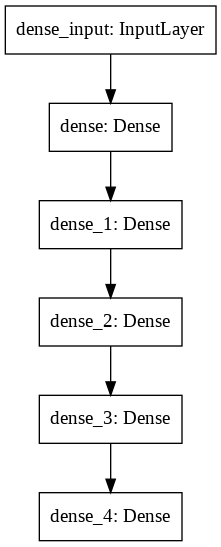

In [27]:
tf.keras.utils.plot_model(
    model, to_file='model.png', show_shapes=False, show_layer_names=True,
    rankdir='TB', expand_nested=False, dpi=96
)

### why weight initiliation : istdev (pylearn)
The weight initialization technique you choose for your neural network can determine how quickly the network converges or whether it converges at all. Although the initial values of these weights are just one parameter among many to tune, they are incredibly important. Their distribution affects the gradients and, therefore, the effectiveness of training.

## Recommendations and Evaluations

### Weight Initialization
Entering the initial state of all the weights in the neural network. Initial weights are used to prevent the exploding / vanishing gradient problem. The exploding / vanishing gradient problem causes the neural network to update with too small / too large of values to effectively train the network. They used an N(0, 0.1) distribution in the first layer, N(0, 0.05) in all hidden layers, and N(0, 0.001) in the output layer. Since we recommend a ReLU activation function, we recommend using Kaiming Initialization. This initialization will help avoid the exploding / vanishing gradient problem, and may increase the speed in which the neural network trains. 

### Activation Functions
An activation function is an equation that determines the value of a neuron using the previous layer’s values. The activation function itself is a transformation that takes (input * neuron weight + bias) of the previous layer, inputs that into the function, and uses the output of the function as the “activation” of the neuron. This “activation” is used as input for the next layer in the network, or is the output of the network itself if the layer that the activation occurs at is the output layer. They use a tanh activation function for hidden layers and sigmoid for the output layer. We recommend using Leaky ReLU instead. Problems with the sigmoid and tanh functions include the vanishing gradient and that they are computationally intensive. Leaky ReLU is more computationally efficient than sigmoid and tanh, which would result in faster training of the model. We recommend Leaky ReLU instead of regular ReLU as some inputs are close to 0 and some are negative, which is not compatable with regular ReLU.  

### Neuron / Hidden Layer Count
Increasing neurons would increase the number of neurons in a specific hidden layer. Increasing the number of hidden layers would increase the number of layers between the input and output layer. Increasing hidden layers and neurons would allow for more non-linear behavior to be modeled by the neural network. They use 300 neurons per hidden layer and four hidden layers. Although they mentioned in the paper that adding more hidden layers and neurons increased training time without noticeably increasing performance, we recommend adding more hidden layers and hidden neurons. Adding extra hidden neurons and hidden layers could discover more non-linear trends in the data when paired with the other changes that we recommend. These extra trends discovered by the neural network could potentially increase model accuracy and allow for even more accurate predictions. Advancements in computational power since this paper was written could reduce the fears of extra computational time.

### Learning Rate
The learning rate controls how much the weights of the network should change with each iteration. The learning rate controls the trade off between convergence speed and overshooting the target. A learning rate that is too large will overshoot equilibrium, while a learning rate that is too small will take an extremely long time to reach equilibrium. They used an initial learning weight of 0.05, decaying by a factor of 1.0000002 each batch update until a minimum of 10^-6. We recommend using an adaptive gradient descent algorithm such as Adam. This algorithm stores the past gradients and past momentums and takes the weighted average (more recent = larger weight) in order to get a more appropriate learning rate for the data. Larger changes in the past result in larger changes in the present, while smaller changes in the past result in smaller changes in the present. This could cause the network to converge faster, without risking overshooting its target. 

### Batch Size
The batch size is the number of samples that will be used to calculate the error gradient. The batch size controls the accuracy of the “step” the neural network takes to minimize the loss function. The larger the batch size, the more accurate the step, but the longer the network takes per step. They use a batch size of 100, and we recommend using hyperparameter tuning to test batch sizes of 50, 100, 150, and 200. With modern computational advancements, we have fewer concerns about the time it would take to tune this parameter, and tuning batch size may lead to better results.

### Most Useful Evaluation Metric
In comparing their models, they use the area under the curve (AUC). This metric gives us a sense of how well our model performs in terms of Background Rejection and Signal Efficiency, or how well our model does at avoiding false positives and hitting true positives. In order to directly compare our models to theirs, we should also use this metric. It wouldn’t make sense to score our models using a metric that they didn’t use; we want an apples-to-apples comparison. They also list the standard deviation of the AUC, so we should do the same.

Since they show that small increases in AUC result in large increases in discovery significance, we don’t need to calculate this as well. Increases in discovery significance are inherent in AUC increases. 


## Conclusion

In this report, we rebuilt the neural network from the architecture outlined in the research paper Searching for Exotic Particles in High-Energy Physics with Deep Learning. Since the original paper was published in 2014, the original packages have been depricated. To overcome this, we used TensorFlow in place of PyLearn2. In addition to the changing packages, the state of the art of neural networks has evolved. Algorithms and computing power have gotten better since 2014. Thus, we recommend increasing the batch size, using an adaptive graident descent algorithm, increasing the hidden layer count and number of neurons per hidden layer, using leaky ReLU as the activation function and using Kaiming Initialization to initialize weights. With the advancements in cloud computing systems, it is our hope that hyperparameter tuning of a deep learning neural network may be cheaper to achieve than it was in 2014. The search for exotic particles is a complicated task, but as neural networks and computational power evolves, we believe that technology will aid further in discovery.